In [1]:
import os
import random
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

In [2]:
# Small number added to near-zero quantities to avoid numerical instability.
_EPS = 1e-7


def remove_flare(combined, flare, gamma=2.2):
    """Subtracts flare from the image in linear space.

    Args:
      combined: gamma-encoded image of a flare-polluted scene.
      flare: gamma-encoded image of the flare.
      gamma: [value in linear domain] = [gamma-encoded value] ^ gamma.

    Returns:
      Gamma-encoded flare-free scene.
    """
    # Avoid zero. Otherwise, the gradient of pow() below will be undefined when
    # gamma < 1.
    combined = tf.clip_by_value(combined, _EPS, 1.0)
    flare = tf.clip_by_value(flare, _EPS, 1.0)

    combined_linear = tf.pow(combined, gamma)
    flare_linear = tf.pow(flare, gamma)

    scene_linear = combined_linear - flare_linear
    # Avoid zero. Otherwise, the gradient of pow() below will be undefined when
    # gamma > 1.
    scene_linear = tf.clip_by_value(scene_linear, _EPS, 1.0)
    scene = tf.pow(scene_linear, 1.0 / gamma)
    return scene


def blend_light_source(in_image, out_image):
    """Adds suspected light source in the input to the flare-free image."""

    I = in_image[:, :, 0]+in_image[:, :, 1]+in_image[:, :, 2]
    I = I/3
    I = (I - tf.math.reduce_min(I))
    I = I/tf.math.reduce_max(I)
    weight = (I)**15
    out1 = out_image[:, :, 0]*(1-weight)+in_image[:, :, 0]*weight
    out2 = out_image[:, :, 1]*(1-weight)+in_image[:, :, 1]*weight
    out3 = out_image[:, :, 2]*(1-weight)+in_image[:, :, 2]*weight

    return tf.stack([out1, out2, out3], axis=-1)


def center_crop(image, width, height):
    """Returns the center crop of a given image."""
    old_height, old_width, _ = image.shape
    x_offset = (old_width - width) // 2
    y_offset = (old_height - height) // 2
    if x_offset < 0 or y_offset < 0:
        raise ValueError('The specified output size is bigger than the image size.')
    return image[y_offset:(y_offset + height), x_offset:(x_offset + width), :]


def process_one_image(model, image_path):
    """Reads one image and writes inference results to disk."""
    with tf.io.gfile.GFile(image_path, 'rb') as f:
        blob = f.read()
    input_u8 = tf.image.decode_image(blob)[Ellipsis, :3]
    input_f32 = tf.image.convert_image_dtype(input_u8, tf.float32, saturate=True)
    h, w, _ = input_f32.shape
    
    if min(h, w) >= 2048:
        input_image = center_crop(input_f32, 2048, 2048)[None, Ellipsis]
        input_low = tf.image.resize(input_image, [512, 512], method=tf.image.ResizeMethod.AREA)
        pred_scene_low = tf.clip_by_value(model(input_low)['output_1'], 0.0, 1.0)  # Extract tensor from dict
        pred_flare_low = remove_flare(input_low, pred_scene_low)
        pred_flare = tf.image.resize(pred_flare_low, [2048, 2048], antialias=True)
        pred_scene = remove_flare(input_image, pred_flare)
    else:
        input_image = center_crop(input_f32, 512, 512)[None, Ellipsis]
        input_image = tf.concat([input_image] * 2, axis=0)
        model_output = model(input_image)
        if isinstance(model_output, dict):
            model_output = model_output['output_1']
        pred_scene = tf.clip_by_value(model_output, 0.0, 1.0)
    
    pred_blend = blend_light_source(input_image[0, Ellipsis], pred_scene[0, Ellipsis])
    return pred_blend


def process_images(model, input_folder, num_images=20):
    # Get list of all images in the folder
    all_images = [os.path.join(input_folder, fname) for fname in os.listdir(input_folder) if fname.endswith(('.jpg', '.png', '.jpeg'))]
    
    # Randomly select 20 images from the folder
    selected_images = random.sample(all_images, num_images)
    
    processed_images = []
    
    i = 1
    for image_path in selected_images:
        pred_blend = process_one_image(model, image_path)
        processed_images.append((image_path, pred_blend))
        if i%10 == 0: print(f"Proccessed {i}/{num_images}")
        i+=1
    
    return processed_images


def detect_edges(image):
    """Detect edges using custom Sobel filters to avoid MirrorPad issues."""
    # Convert to grayscale if the image is in RGB
    if image.shape[-1] == 3:
        image = tf.image.rgb_to_grayscale(image)
    
    # Reshape image to add batch dimension
    image = tf.expand_dims(image, axis=0)
    
    # Define Sobel filters for x and y directions
    sobel_x = tf.constant([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype=tf.float32)
    sobel_y = tf.constant([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype=tf.float32)
    
    # Reshape Sobel filters for convolution
    sobel_x = sobel_x[:, :, tf.newaxis, tf.newaxis]
    sobel_y = sobel_y[:, :, tf.newaxis, tf.newaxis]
    
    # Apply the Sobel filters using convolution
    edge_x = tf.nn.conv2d(image, sobel_x, strides=[1, 1, 1, 1], padding="SAME")
    edge_y = tf.nn.conv2d(image, sobel_y, strides=[1, 1, 1, 1], padding="SAME")
    
    # Compute the magnitude of the edges
    edges = tf.sqrt(tf.square(edge_x) + tf.square(edge_y))
    
    # Squeeze out the batch dimension
    edges = tf.squeeze(edges)
    
    return edges


def calculate_edge_change_percentage(input_edges, output_edges):
    """Calculate the percentage change in edges between input and output images."""
    # Calculate the number of edge pixels in both input and output edge maps
    input_edge_pixels = tf.math.count_nonzero(input_edges > 0.01)
    output_edge_pixels = tf.math.count_nonzero(output_edges > 0.01)

    # Calculate the total number of pixels in the image
    total_pixels = tf.size(input_edges, out_type=tf.int64)

    # Calculate the percentage of edge pixels in both images
    input_edge_percentage = input_edge_pixels / tf.cast(total_pixels, tf.int64) * 100
    output_edge_percentage = output_edge_pixels / tf.cast(total_pixels, tf.int64) * 100

    # Calculate the percentage change
    edge_change_percentage = ((output_edge_percentage - input_edge_percentage) / input_edge_percentage) * 100

    return edge_change_percentage.numpy()


def calculate_contrast(image):
    """Calculates the RMS contrast of an image."""
    grayscale_image = tf.image.rgb_to_grayscale(image)
    mean_brightness = tf.reduce_mean(grayscale_image)
    contrast = tf.sqrt(tf.reduce_mean(tf.square(grayscale_image - mean_brightness)))
    return contrast



def calculate_brightness_consistency(input_image_tensor, output_image):
    """Calculate the percentage change in brightness consistency between input and output images."""
    
    # Convert both input and output images to grayscale
    input_gray = tf.image.rgb_to_grayscale(input_image_tensor)  # Convert to grayscale
    output_gray = tf.image.rgb_to_grayscale(output_image)  # Convert to grayscale
    
    # Calculate mean brightness for both images
    input_brightness = tf.reduce_mean(input_gray)  # Mean brightness of input image
    output_brightness = tf.reduce_mean(output_gray)  # Mean brightness of output image
    
    # Calculate the percentage change in brightness consistency
    brightness_change_percentage = ((output_brightness - input_brightness) / input_brightness) * 100
    
    return brightness_change_percentage.numpy()


def display_images_side_by_side(image_pairs):
    """Display input and output images side by side with edge restoration percentage."""
    num_images = len(image_pairs)
    
    # Set up the subplot grid
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 6))  # Adjusted figure size for better visibility
    
    for i, (input_path, output_image) in enumerate(image_pairs):
        # Read and display input image
        input_image = plt.imread(input_path)
        input_image_tensor = tf.convert_to_tensor(input_image, dtype=tf.float32)
        
        axes[i, 0].imshow(input_image)
        axes[i, 0].axis('off')
        axes[i, 0].set_title(f'Input Image {i + 1}', fontsize=16)
        
        # Display output image
        axes[i, 1].imshow(np.clip(output_image.numpy(), 0, 1))
        axes[i, 1].axis('off')
        axes[i, 1].set_title(f'Output Image {i + 1}', fontsize=16)
        
        # Calculate edge density for input and output images
        input_edges = detect_edges(input_image_tensor)
        output_edges = detect_edges(output_image)
        
        # Calculate restoration percentage
        restoration_percentage = calculate_edge_change_percentage(input_edges, output_edges)
        
        # Calculate contrast for both input and output images
        input_contrast = calculate_contrast(input_image_tensor)
        output_contrast = calculate_contrast(output_image)
        
        # Calculate the improvement percentage
        contrast_improvement = ((output_contrast - input_contrast) / input_contrast) * 100
        
        # Calculate brightness consistency:
        brightness_change = calculate_brightness_consistency(input_image_tensor, output_image)
        
        # Display restoration percentage as text below the images
        axes[i, 1].text(0.5, -0.06, f'Brightness Consistency Improvement: {abs(brightness_change):.2f}%', 
                        ha='center', va='center', transform=axes[i, 1].transAxes, fontsize=12)
        axes[i, 1].text(0.5, -0.12, f'Edge Detection Improvement: {abs(restoration_percentage):.2f}%', 
                        ha='center', va='center', transform=axes[i, 1].transAxes, fontsize=12)
        axes[i, 1].text(0.5, -0.18, f'Contrast Improvement: {abs(contrast_improvement):.2f}%', 
                        ha='center', va='center', transform=axes[i, 1].transAxes, fontsize=12)
    
    plt.show()
    
    
def load_model(model_path):
    """Loads the model using TFSMLayer for Keras 3 compatibility."""
    return tf.keras.layers.TFSMLayer(model_path, call_endpoint='serving_default')

In [3]:
input_folder = '/kaggle/input/test-data-clear-glare-v1/input'
model = tf.keras.layers.TFSMLayer('/kaggle/input/model_clear_glare_v1/tensorflow2/default/1/trained_model', call_endpoint='serving_default')

I0000 00:00:1731248790.506398      64 service.cc:145] XLA service 0x7cab88d010a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1731248790.506455      64 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1731248790.760752      64 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


Proccessed 10/40
Proccessed 20/40
Proccessed 30/40
Proccessed 40/40


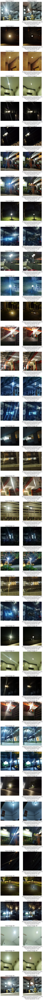

In [4]:
random.seed(69)
processed_image_pairs = process_images(model, input_folder, num_images=40)
display_images_side_by_side(processed_image_pairs)

In [5]:
# processed_image = process_one_image(model, '/kaggle/input/test-data-clear-glare-v1/input/input_000000.png')

# Display the processed image
# plt.figure(figsize=(8, 8))
# plt.imshow(np.clip(processed_image.numpy(), 0, 1))  # Clip values to [0, 1] for visualization
# plt.axis('off')  # Hide axes
# plt.title('Processed Image')  # Title for the image
# plt.show()